Conversion of the color image to grayscale, using the proper coefficients of Red, Green and Blue.

Original Image: books


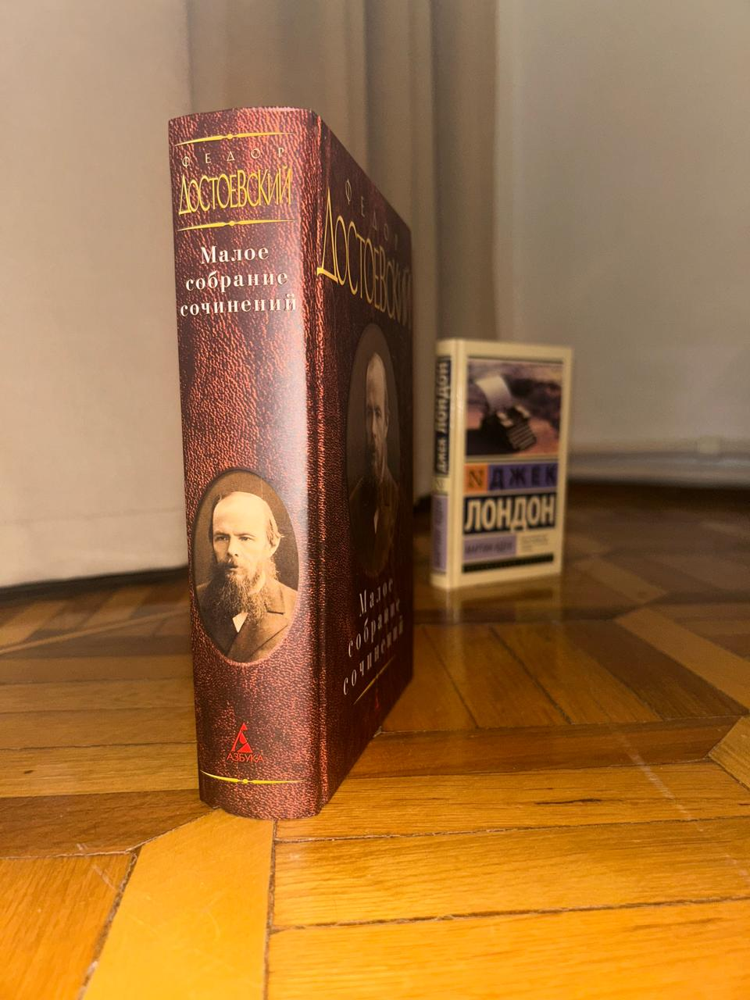

Grayscale (NTSC Method):


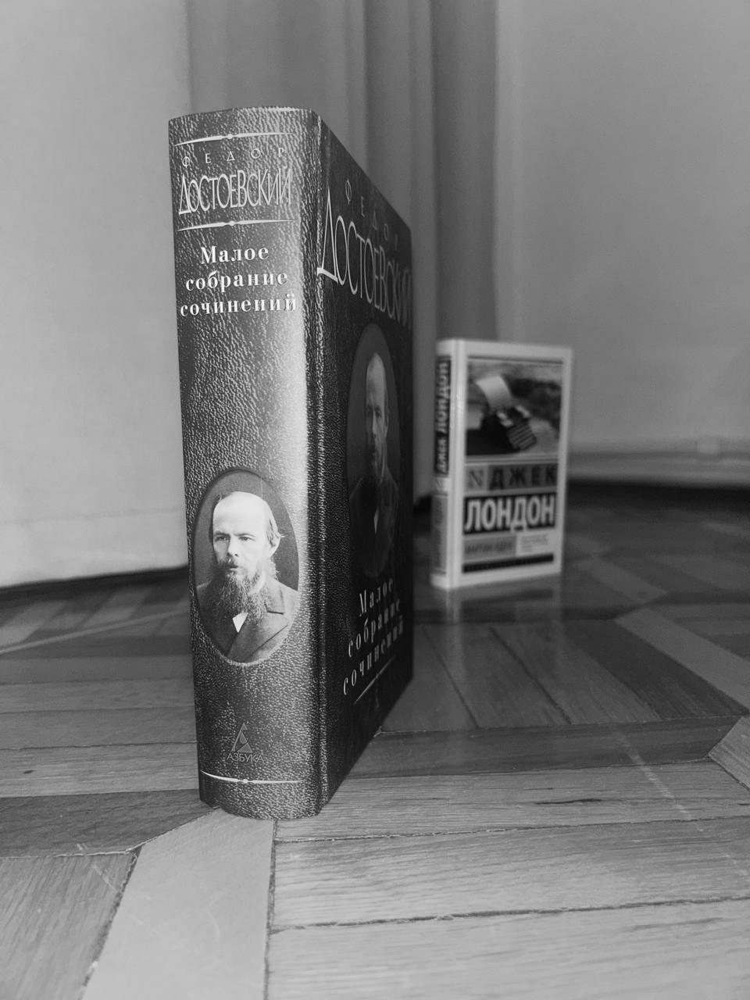

Grayscale (Average Method):


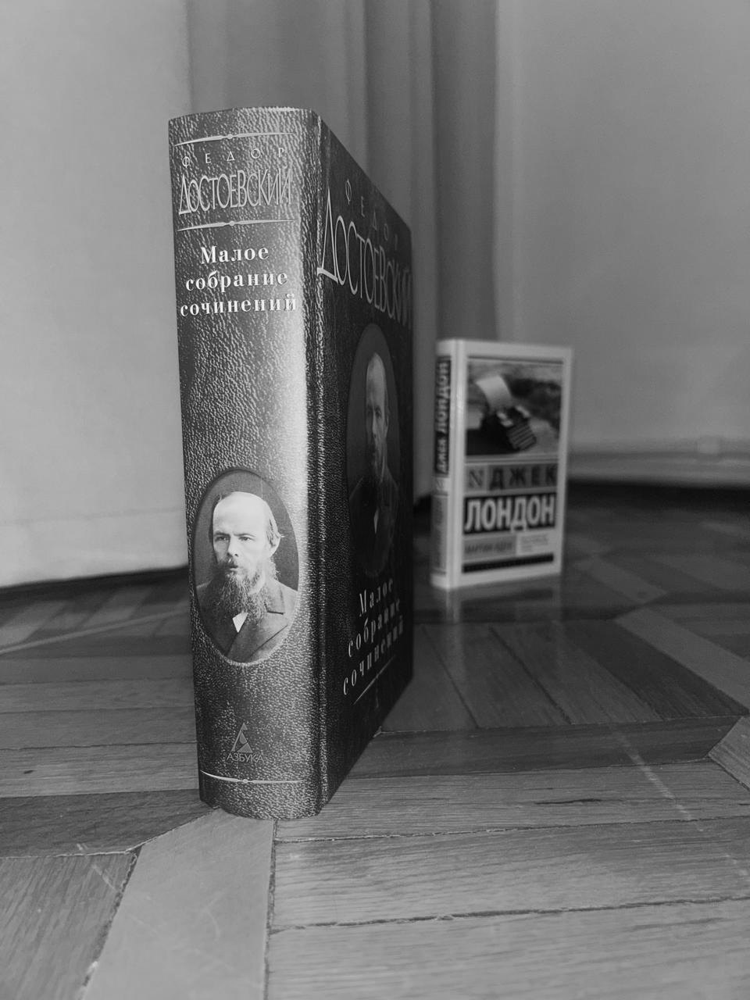

Original Image: chess


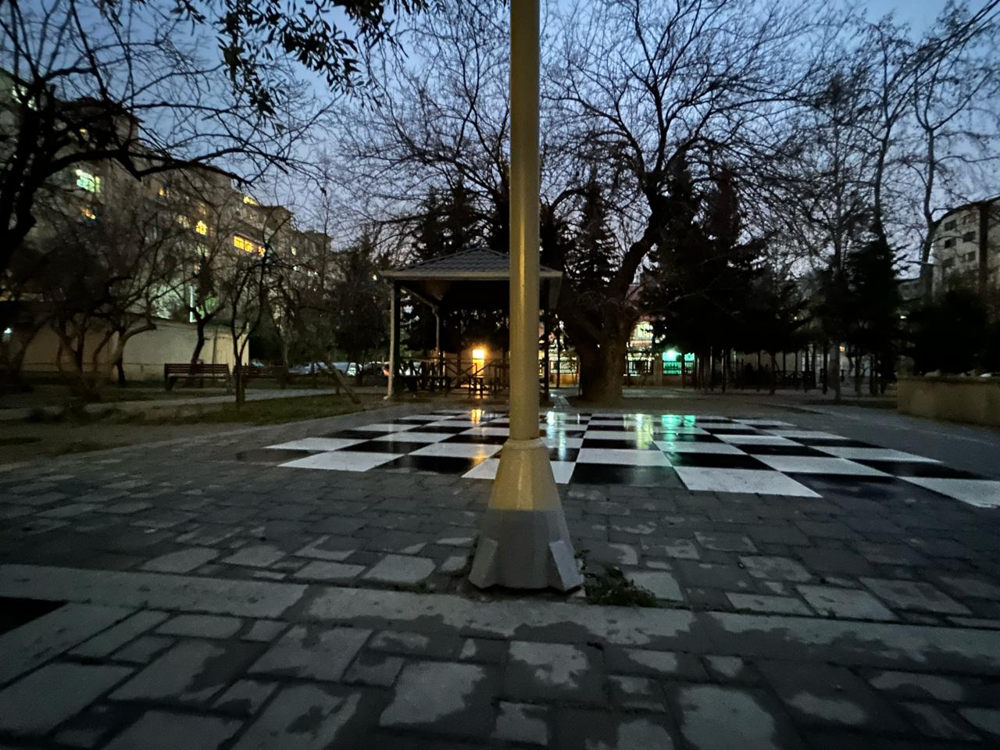

Grayscale (NTSC Method):


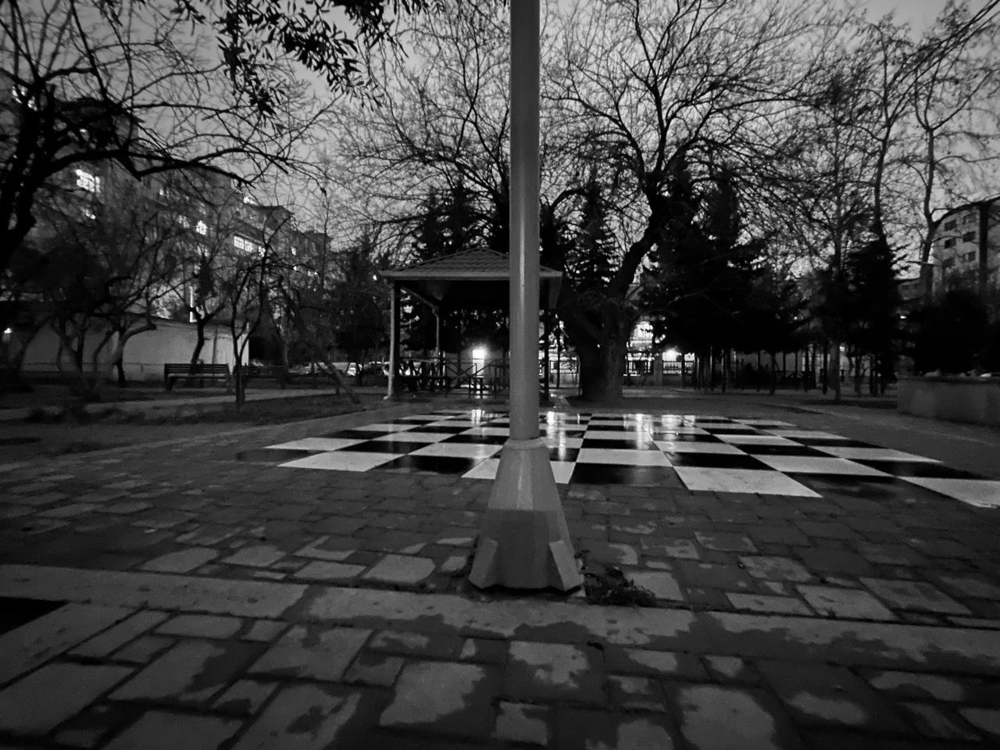

Grayscale (Average Method):


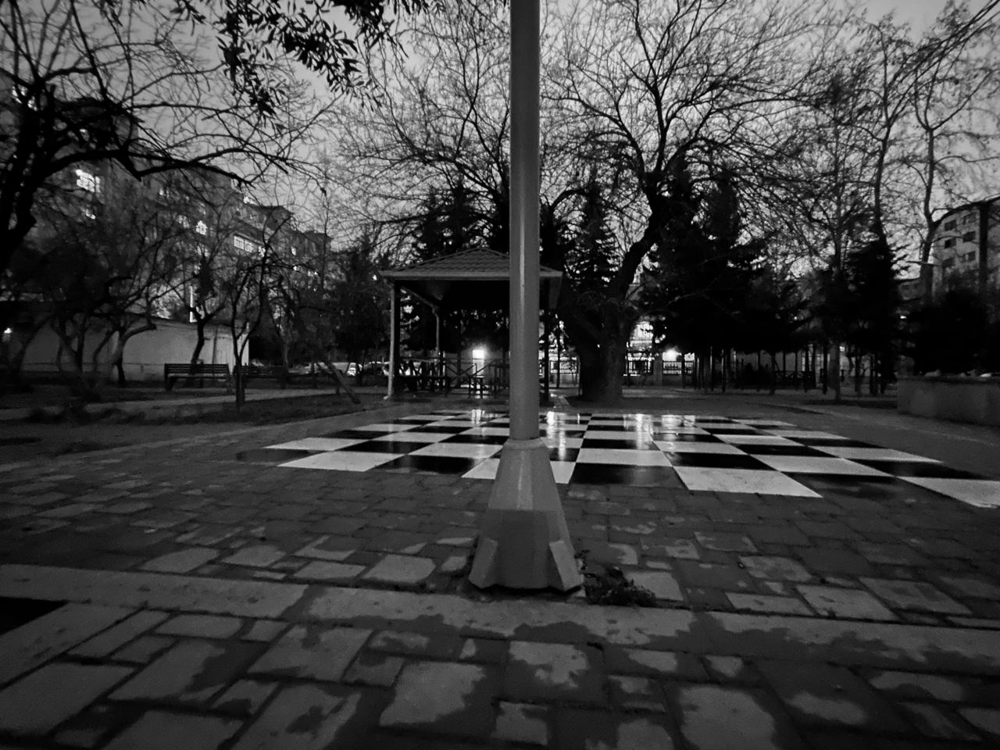

Original Image: desk


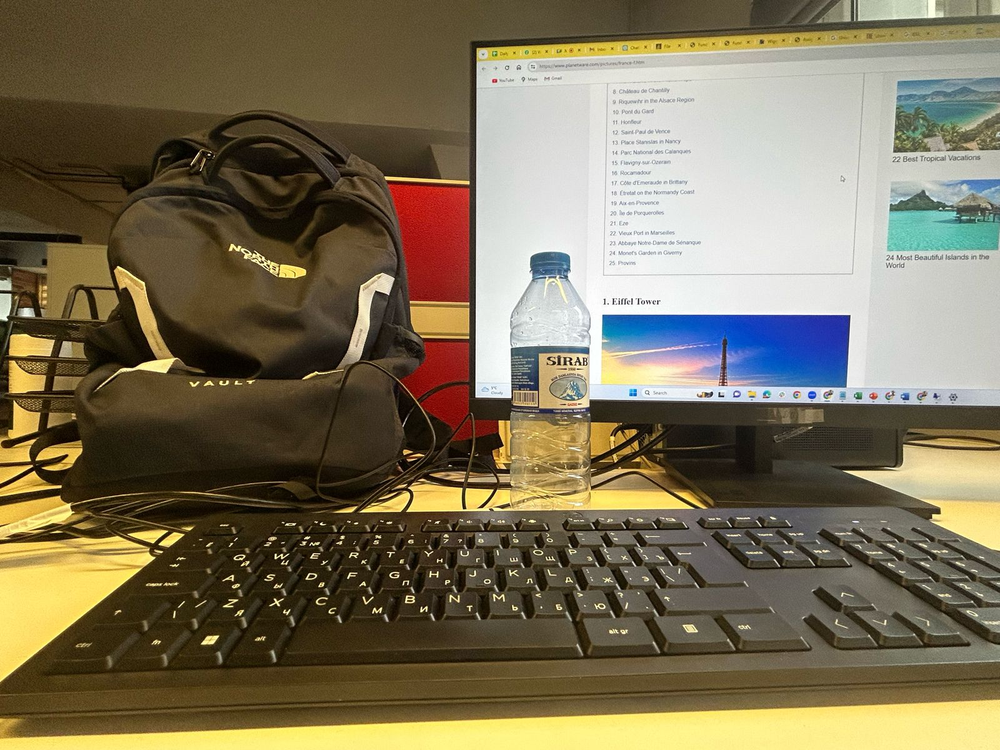

Grayscale (NTSC Method):


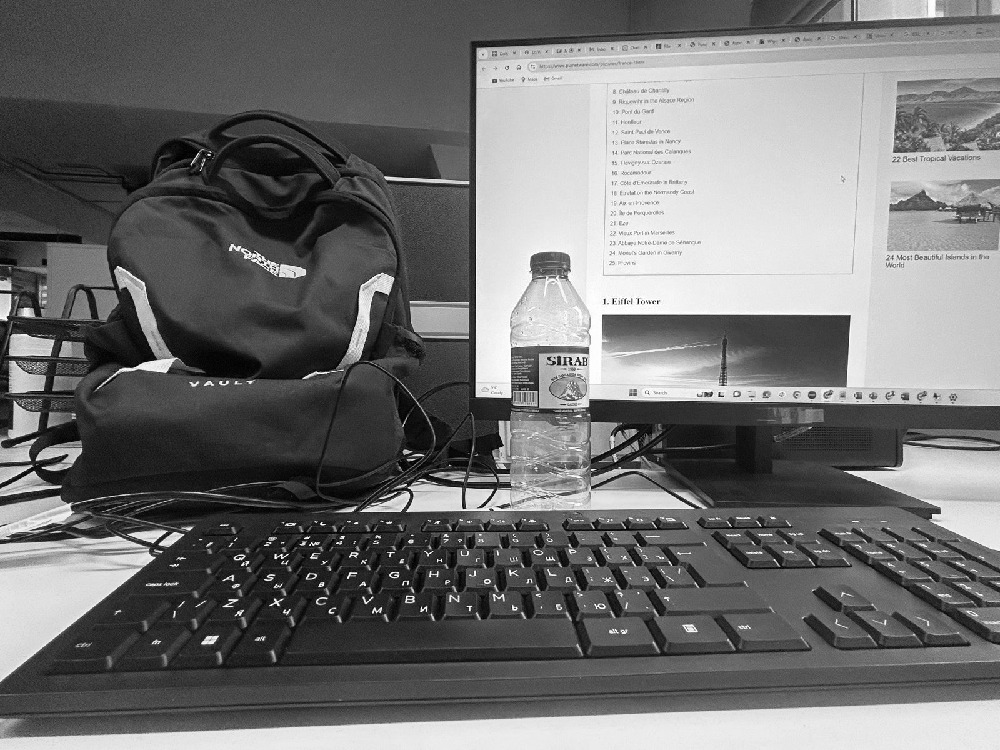

Grayscale (Average Method):


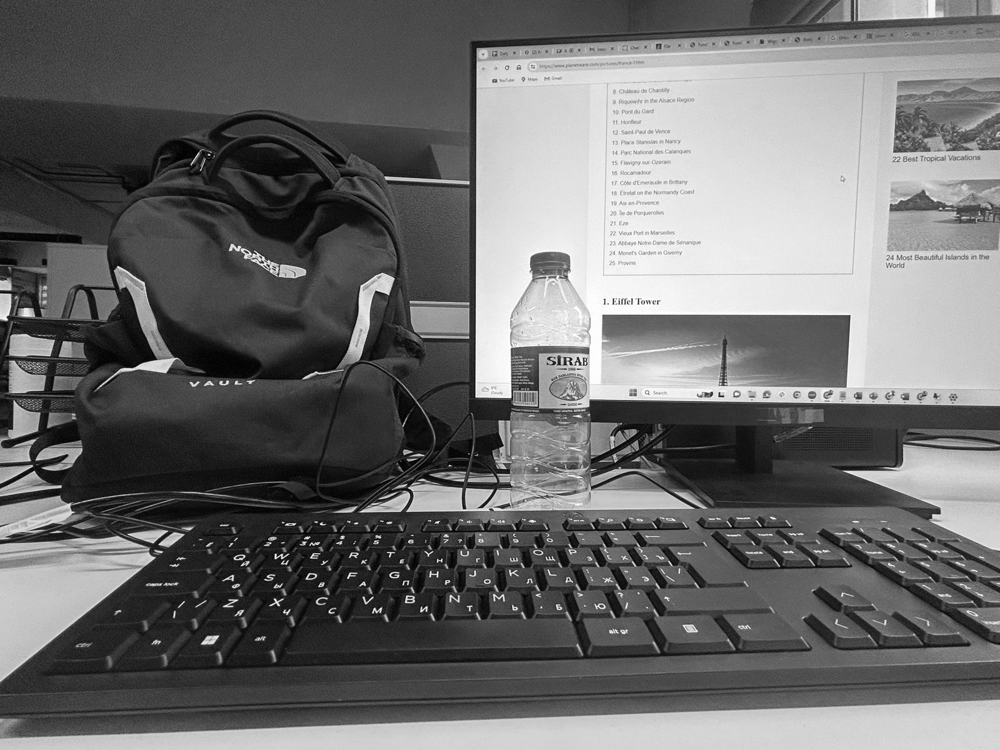

Original Image: matryoshka


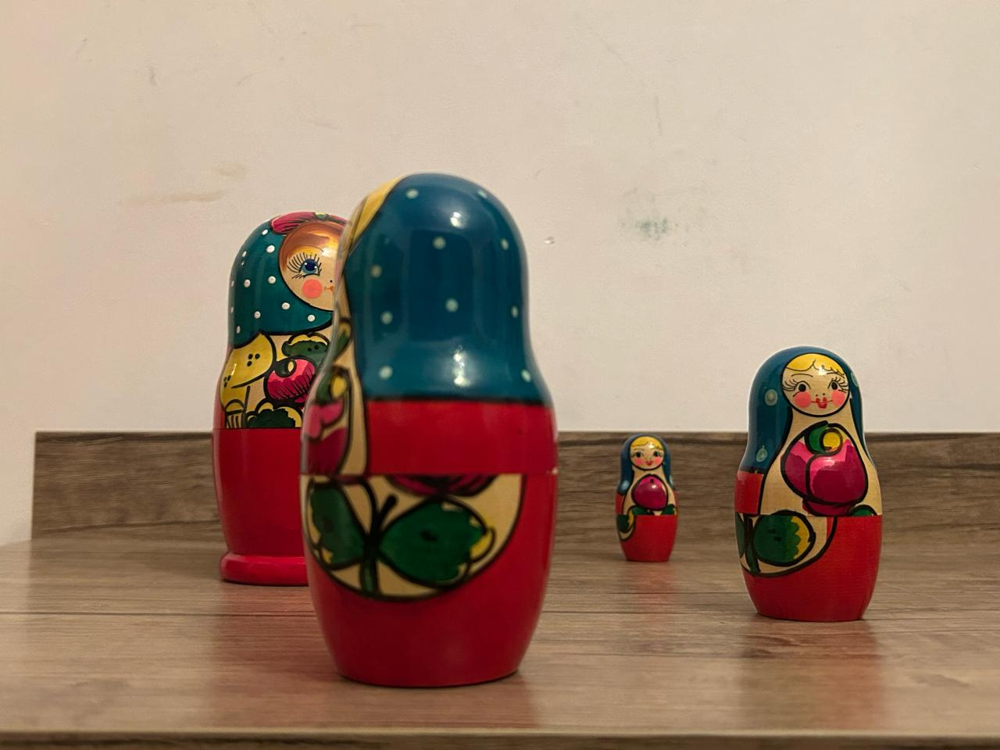

Grayscale (NTSC Method):


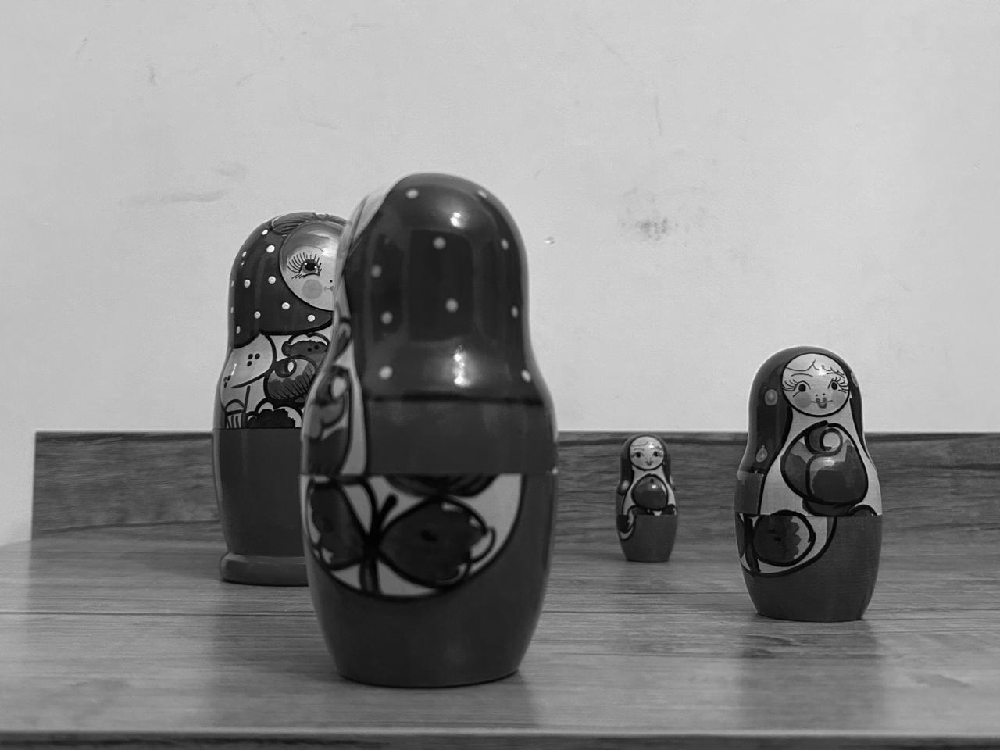

Grayscale (Average Method):


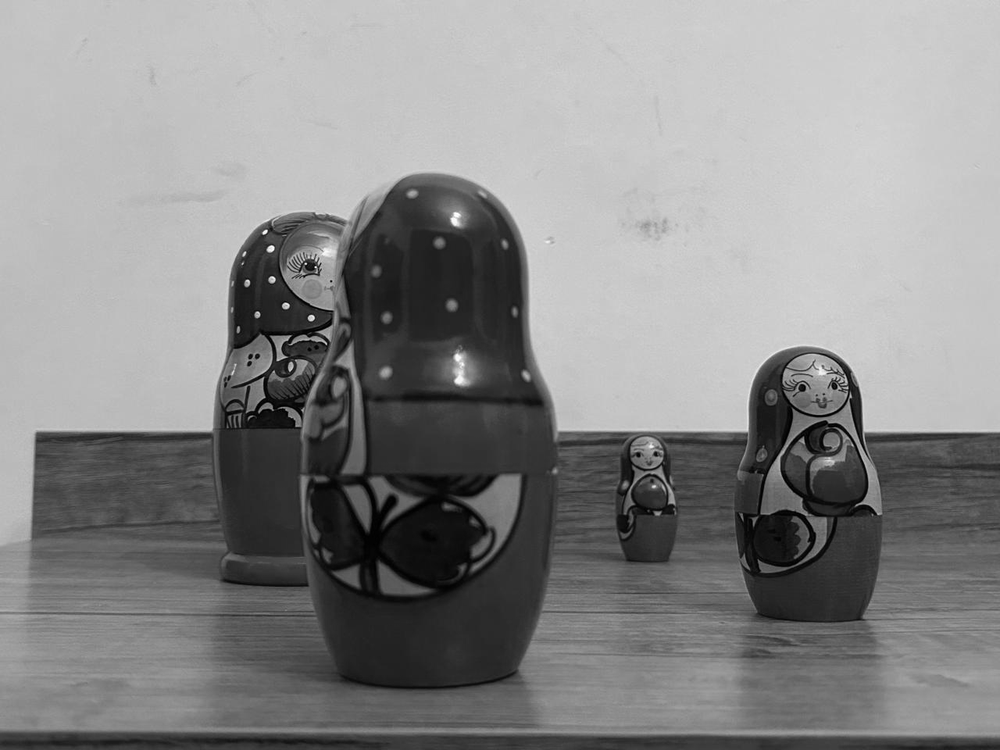

Original Image: radio


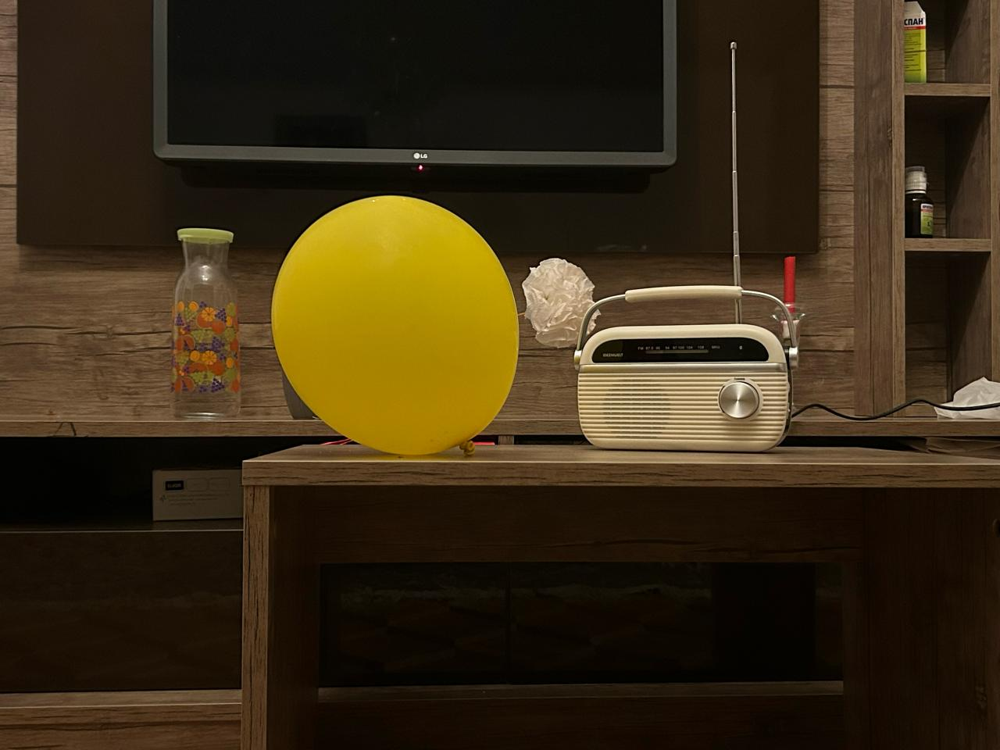

Grayscale (NTSC Method):


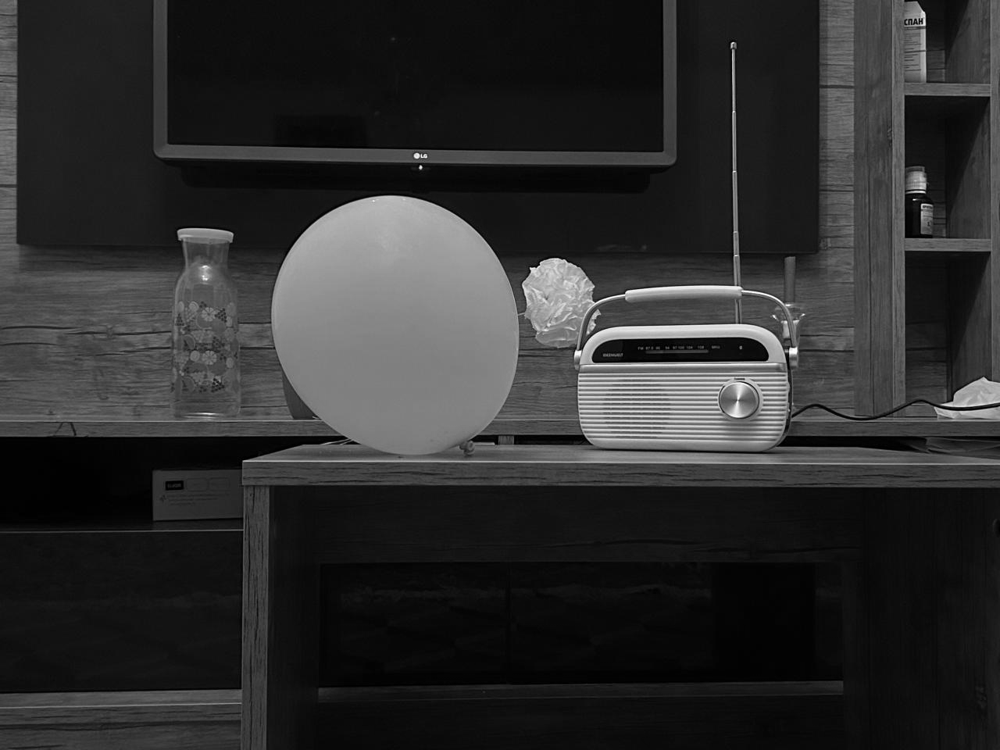

Grayscale (Average Method):


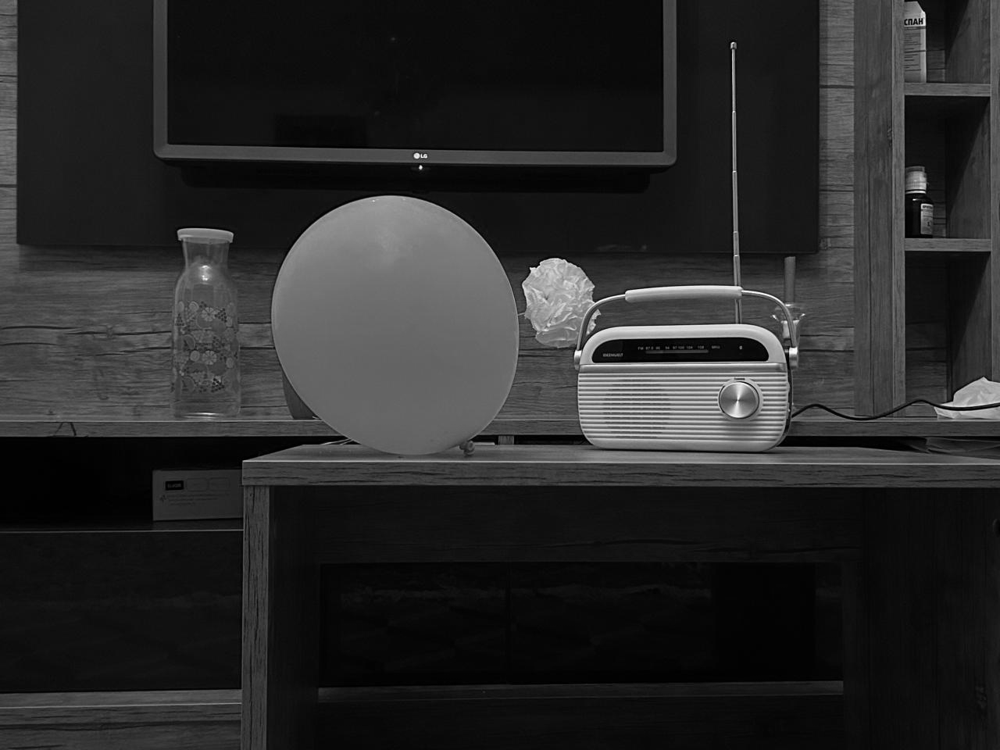

In [7]:
from PIL import Image
import numpy as np

# Define the path to your image - replace this with the correct path to your image file
image_path = '/content/matryoshka.jpeg'

# Load the image from file
image = Image.open(image_path)

# Function to convert an image to grayscale using the NTSC (National Television System Committee) formula
# This method weighs the RGB channels according to human perception
def to_grayscale_NTSC(img):
    # Convert the image to a numpy array for manipulation
    np_img = np.array(img)
    # Calculate the grayscale value using the NTSC formula
    gray = 0.299 * np_img[:, :, 0] + 0.587 * np_img[:, :, 1] + 0.114 * np_img[:, :, 2]
    # Convert the numpy array back to a PIL Image and return
    return Image.fromarray(np.uint8(gray))

# Function to convert an image to grayscale by averaging the RGB values
def to_grayscale_average(img):
    # Convert the image to a numpy array for manipulation
    np_img = np.array(img)
    # Calculate the average of the RGB channels
    gray = np.mean(np_img, axis=2)
    # Convert the numpy array back to a PIL Image and return
    return Image.fromarray(np.uint8(gray))




# List of image filenames
image_filenames = ["books", "chess", "desk", "matryoshka", "radio"]


# Directory where the images are stored
directory = '/content/'  # Update this path to your images directory


# Iterate over the image filenames
for filename in image_filenames:
    # Construct the full image path
    image_path = f'{directory}{filename}.jpeg'  # all images are JPEGs

    # Load the image from file
    image = Image.open(image_path)
    # Convert the original image to grayscale using both methods
    grayscale_NTSC = to_grayscale_NTSC(image)
    grayscale_average = to_grayscale_average(image)

    # Display the original image and its grayscale versions
    print(f"Original Image: {filename}")
    display(image)
    print("Grayscale (NTSC Method):")
    display(grayscale_NTSC)
    print("Grayscale (Average Method):")
    display(grayscale_average)

    # Optionally, save the grayscale images to disk
    grayscale_NTSC.save(f"{filename}_grayscale_NTSC.jpg")
    grayscale_average.save(f"{filename}_grayscale_average.jpg")



 Quantitative Comparison of the averaging method when each color components have 1/3 weight and NTSC Method:

NTSC Method: Mean = 140.1889200846354, Standard Deviation = 66.67641647138772
Averaging Method: Mean = 137.16956217447915, Standard Deviation = 65.0926175487364


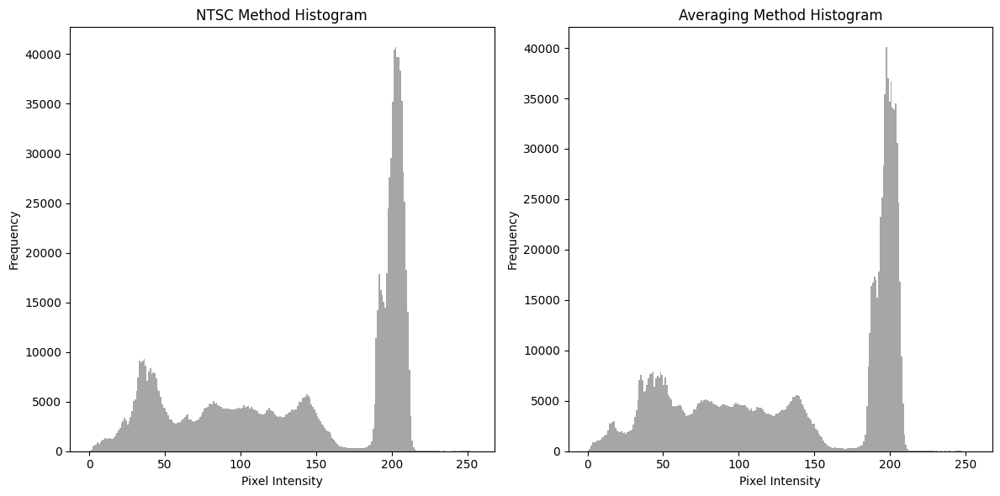

In [11]:
import matplotlib.pyplot as plt

def calculate_statistics(img):
    """Calculate and return the mean and standard deviation of the image."""
    np_img = np.array(img)
    mean = np.mean(np_img)
    std = np.std(np_img)
    return mean, std

image = Image.open("/content/matryoshka.jpeg")
# Convert the original image to grayscale using both methods
grayscale_NTSC = to_grayscale_NTSC(image)
grayscale_average = to_grayscale_average(image)

# Calculate statistics for each method
ntsc_mean, ntsc_std = calculate_statistics(grayscale_NTSC)
average_mean, average_std = calculate_statistics(grayscale_average)

print(f"NTSC Method: Mean = {ntsc_mean}, Standard Deviation = {ntsc_std}")
print(f"Averaging Method: Mean = {average_mean}, Standard Deviation = {average_std}")

# Plot histograms for visual comparison
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(np.array(grayscale_NTSC).flatten(), bins=256, color='gray', alpha=0.7, label='NTSC')
plt.title('NTSC Method Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(np.array(grayscale_average).flatten(), bins=256, color='gray', alpha=0.7, label='Average')
plt.title('Averaging Method Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


### Qualitative Comparison:

- **NTSC Method**: This method applies different weights to the RGB components based on human perception sensitivity. Humans are more sensitive to green light, so the green component has a higher weight. The resulting grayscale image often appears more balanced and true to the perceived brightness of the original color image.

- **Averaging Method (Equal Weights)**: By giving each RGB component the same weight (1/3 each), this method treats all colors equally. This approach might not always align with human visual perception, potentially leading to a grayscale image that feels less dynamically balanced compared to the NTSC method.


### Color Quantization Algorithms on the Images:

#### Used Algorithms: K-means, Uniform Quantization

- **K-means Quantization**: This algorithm partitions the image's color space into \(K\) clusters, where \(K\) is a predefined number of colors to be used in the quantized image. It iteratively refines the position of centroids (the average of the colors in a cluster) and reassigns pixels to the closest centroid, minimizing the distance between pixels and centroids. This method is effective for reducing the number of colors while maintaining the perceptual quality of the image.

- **Uniform Quantization**: Unlike K-means, Uniform Quantization simplifies the color space by uniformly dividing it into bins across each color dimension (RGB). Each color in the original image is then mapped to the closest color in this simplified palette. This method is computationally less intensive but might not preserve the image's visual quality as effectively as K-means, especially with a low number of colors.


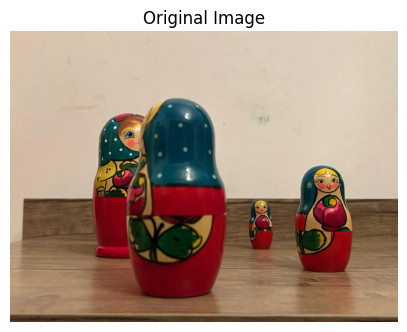

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


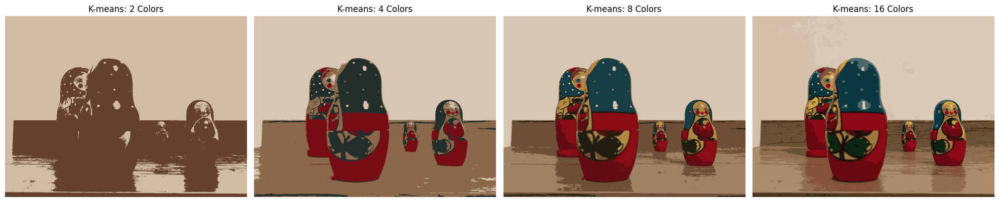

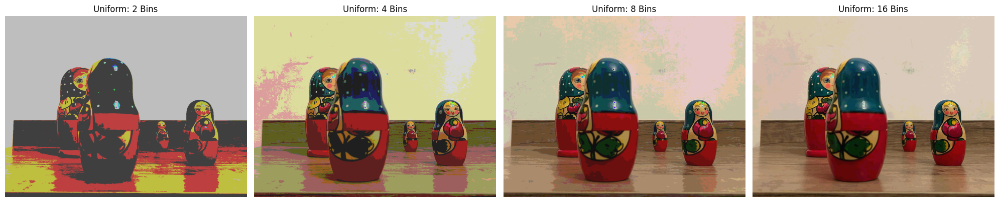

In [18]:
from sklearn.cluster import KMeans
from skimage.color import rgb2lab, lab2rgb

# Define the path to your image
image_path = '/content/matryoshka.jpeg'
image = Image.open(image_path)

# Define quantization functions
def kmean_quantize_colors(img, n_colors):
    np_img = np.array(img)
    lab_img = rgb2lab(np_img.reshape((-1, 3)))
    kmeans = KMeans(n_clusters=n_colors)
    labels = kmeans.fit_predict(lab_img)
    quantized_lab = kmeans.cluster_centers_[labels]
    quantized_img = lab2rgb(quantized_lab.reshape(np_img.shape))
    return Image.fromarray((quantized_img * 255).astype(np.uint8))

def uniform_quantize_colors(img, n_bins):
    np_img = np.array(img)
    max_val = 255
    bin_width = max_val // n_bins
    quantized_img = ((np_img // bin_width) * bin_width + bin_width // 2)
    return Image.fromarray(np.uint8(quantized_img))

# Parameters for quantization
n_colors_set = [2, 4, 8, 16]
n_bins_set = [2, 4, 8, 16]

# Display the original image
plt.figure(figsize=(5, 5))
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')
plt.show()

# Display K-means quantized images
plt.figure(figsize=(20, 10))
for i, n_colors in enumerate(n_colors_set, 1):
    quantized_image = kmean_quantize_colors(image, n_colors)
    plt.subplot(1, len(n_colors_set), i)
    plt.imshow(quantized_image)
    plt.title(f'K-means: {n_colors} Colors')
    plt.axis('off')

plt.tight_layout()
plt.show()

# Display uniform quantized images
plt.figure(figsize=(20, 10))
for i, n_bins in enumerate(n_bins_set, 1):
    quantized_image = uniform_quantize_colors(image, n_bins)
    plt.subplot(1, len(n_bins_set), i)
    plt.imshow(quantized_image)
    plt.title(f'Uniform: {n_bins} Bins')
    plt.axis('off')

plt.tight_layout()
plt.show()


# Comparison of Hue, Saturation, Brightness, and Lightness Adjustments

## Hue

- **Definition**: Hue represents the color itself, the aspect of color which is described by names like red, green, blue, etc.
- **Impact**: Adjusting the hue changes the base color (or wavelength) of the image pixels without altering the brightness or saturation. This can shift the entire color spectrum of the image, leading to a visually different color appearance.

## Saturation

- **Definition**: Saturation measures the intensity or purity of a color. It represents how far a color is from a gray of the same brightness, ranging from fully saturated (pure color) to completely desaturated (gray).
- **Impact**: Adjusting saturation enhances or dulls the colors in an image. Increasing saturation will make colors more vivid, whereas decreasing it will make them closer to gray.

## Brightness

- **Definition**: Brightness refers to the perception of how intense light is. In color models like HSV/HSB, it represents the intensity of the light that a color reflects or emits.
- **Impact**: Brightness adjustments make the image appear lighter or darker. It affects all pixels and can change the overall impression of illumination within the image, without changing the color (hue) or purity (saturation).

## Lightness

- **Definition**: Lightness, in color science, is a measure of the perceived brightness of a color relative to a similarly illuminated white. It's a concept used in HSL and Lab color models to represent a midpoint between the darkest and lightest extremes of color.
- **Impact**: Adjusting lightness affects the perceived illumination of the color, making it appear closer to white or black. This adjustment is designed to maintain the color's hue and saturation while altering how light or dark the color appears.



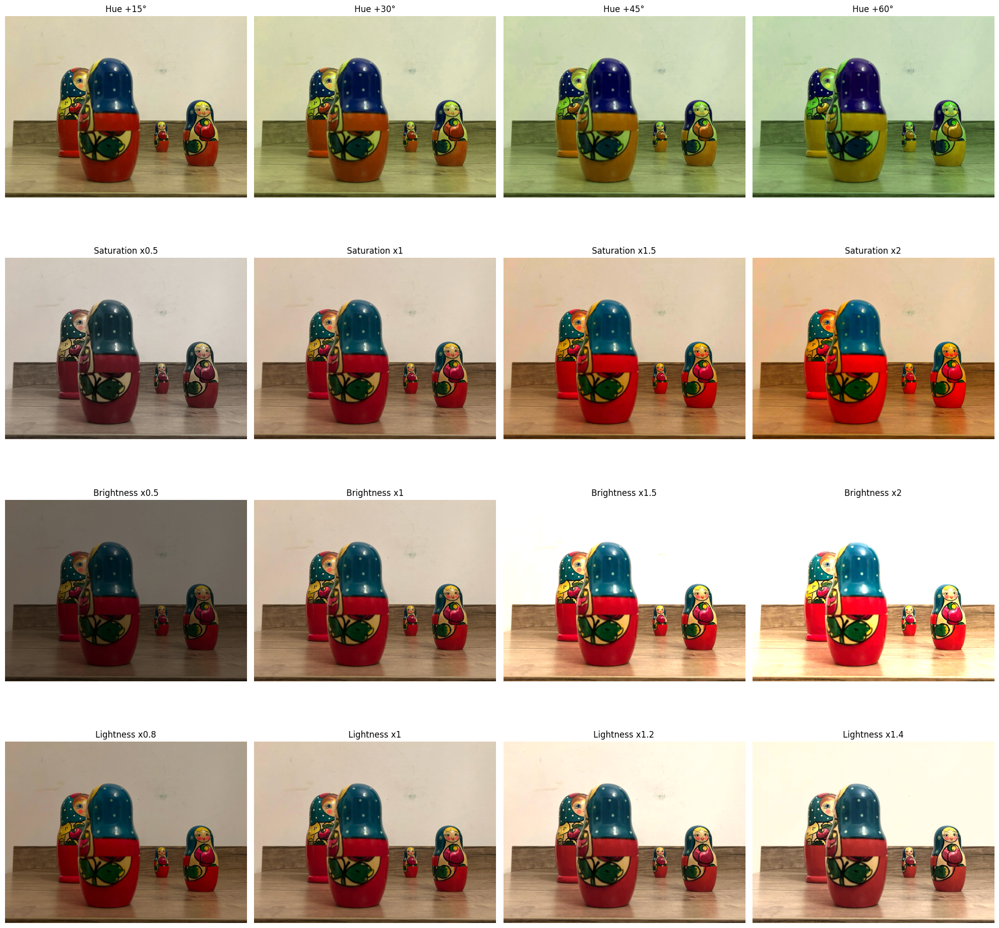

In [23]:
from PIL import Image, ImageEnhance
import matplotlib.pyplot as plt
import numpy as np
import colorsys
from skimage import color

def adjust_hue(image, hue_delta):
    """Adjusts the image's hue."""
    img_np = np.array(image)
    hsv = np.array([[colorsys.rgb_to_hsv(*pixel/255.0) for pixel in row] for row in img_np])
    hsv[:, :, 0] = (hsv[:, :, 0] + hue_delta / 360.0) % 1.0
    rgb = np.array([[colorsys.hsv_to_rgb(*pixel) for pixel in row] for row in hsv]) * 255
    return Image.fromarray(np.uint8(rgb))

def adjust_saturation(image, factor):
    """Adjusts the image's saturation."""
    converter = ImageEnhance.Color(image)
    return converter.enhance(factor)

def adjust_brightness(image, factor):
    """Adjusts the image's brightness."""
    converter = ImageEnhance.Brightness(image)
    return converter.enhance(factor)

def adjust_lightness(image, factor):
    """Adjusts the image's lightness."""
    img_np = np.array(image)
    # Convert RGB to Lab
    lab = color.rgb2lab(img_np)
    # Adjust L* channel
    lab[:, :, 0] = np.clip(lab[:, :, 0] * factor, 0, 100)
    # Convert Lab back to RGB
    rgb = color.lab2rgb(lab)
    return Image.fromarray((rgb * 255).astype(np.uint8))

# Load the image
image_path = '/content/matryoshka.jpeg'
image = Image.open(image_path)

# Define adjustment ranges
hue_deltas = [15, 30, 45, 60]
saturation_factors = [0.5, 1, 1.5, 2]
brightness_factors = [0.5, 1, 1.5, 2]
lightness_factors = [0.8, 1, 1.2, 1.4]  # Adjusting lightness factor

# Create a subplot for each type of adjustment
fig, axs = plt.subplots(4, 4, figsize=(20, 20))

# Adjust and display hue variations
for i, hue_delta in enumerate(hue_deltas):
    axs[0, i].imshow(adjust_hue(image, hue_delta))
    axs[0, i].set_title(f'Hue +{hue_delta}°')
    axs[0, i].axis('off')

# Adjust and display saturation variations
for i, factor in enumerate(saturation_factors):
    axs[1, i].imshow(adjust_saturation(image, factor))
    axs[1, i].set_title(f'Saturation x{factor}')
    axs[1, i].axis('off')

# Adjust and display brightness variations
for i, factor in enumerate(brightness_factors):
    axs[2, i].imshow(adjust_brightness(image, factor))
    axs[2, i].set_title(f'Brightness x{factor}')
    axs[2, i].axis('off')

# Adjust and display lightness variations
for i, factor in enumerate(lightness_factors):
    axs[3, i].imshow(adjust_lightness(image, factor))
    axs[3, i].set_title(f'Lightness x{factor}')
    axs[3, i].axis('off')

plt.tight_layout()
plt.show()
